## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.


## Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.

In [2]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

%matplotlib inline

In [3]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

nx = 9 # the number of inside corners in x
ny = 6 # the number of inside corners in y


In [4]:
# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (nx, ny), corners, ret)

ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

print('mtx: {}'.format(mtx))
print('dist: {}'.format(dist))

mtx: [[  1.15396093e+03   0.00000000e+00   6.69705357e+02]
 [  0.00000000e+00   1.14802496e+03   3.85656234e+02]
 [  0.00000000e+00   0.00000000e+00   1.00000000e+00]]
dist: [[ -2.41017956e-01  -5.30721173e-02  -1.15810355e-03  -1.28318856e-04
    2.67125290e-02]]


In [5]:
def corners_unwarp(img, nx, ny, mtx, dist):
    # Pass in your image into this function
    # Write code to do the following steps
    # 1) Undistort using mtx and dist
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    # 2) Convert to grayscale
    gray = cv2.cvtColor(undist, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
    # 4) If corners found:
    M = [[]]
    warped = gray
    if ret == True:
        # a) draw corners
        # drawn_corners = cv2.drawChessboardCorners(gray, (nx, ny), corners, ret)
        # b) define 4 source points src = np.float32([[,],[,],[,],[,]])
                 #Note: you could pick any four of the detected corners
                 # as long as those four corners define a rectangle
                 #One especially smart way to do this would be to use four well-chosen
                 # corners that were automatically detected during the undistortion steps
                 #We recommend using the automatic detection of corners in your code
        src_tl = corners[0]
        src_tr = corners[nx-1]
        src_bl = corners[-nx]
        src_br = corners[-1]
        src = np.float32([src_tl, src_tr, src_br, src_bl])
        # c) define 4 destination points dst = np.float32([[,],[,],[,],[,]])

        height, width = gray.shape
        dst_tl = [width / (nx * 2), height / (ny * 2)]
        dst_tr = [width * (nx * 2 - 1) / (nx * 2), height / (ny * 2)]
        dst_bl = [width / (nx * 2), height * (ny * 2 - 1) / (ny * 2)]
        dst_br = [width * (nx * 2 - 1) / (nx * 2), height * (ny * 2 - 1) / (ny * 2)]
        dst = np.float32([dst_tl, dst_tr, dst_br, dst_bl])
        # d) use cv2.getPerspectiveTransform() to get M, the transform matrix
        M    = cv2.getPerspectiveTransform(src, dst)
        # e) use cv2.warpPerspective() to warp your image to a top-down view
        warped = cv2.warpPerspective(gray, M, (width, height), flags=cv2.INTER_LINEAR)

    return warped, M



An example before and after the checkerboard undistortion and warping process.


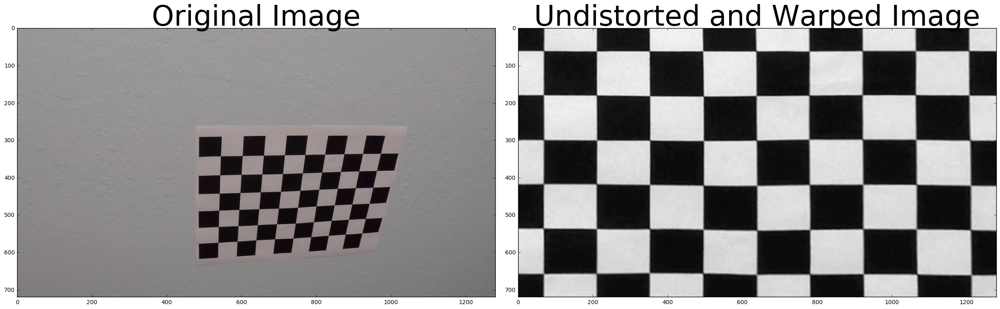

In [6]:
print('An example before and after the checkerboard undistortion and warping process.')
fname = images[1]
# for fname in images:
img = cv2.imread(fname)
top_down, perspective_M = corners_unwarp(img, nx, ny, mtx, dist)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(top_down, cmap='gray')
ax2.set_title('Undistorted and Warped Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Apply a distortion correction to raw images.

An example before and after the undistortion process applied to car view image.


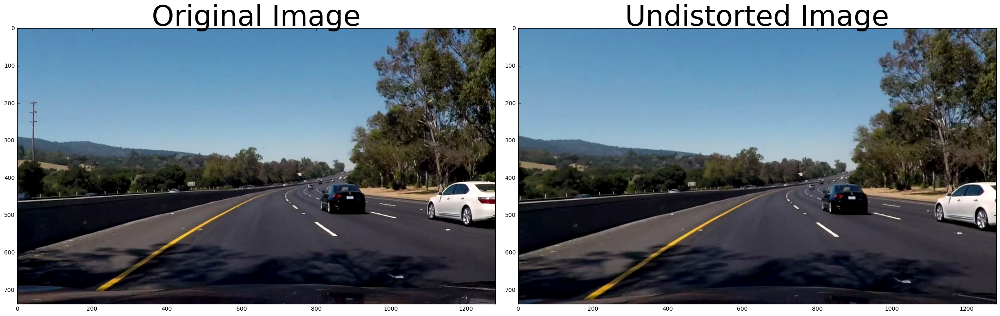

In [18]:
test_images = glob.glob('./project_video_images/*.png')
undistorted_images = []

for fname in test_images:
    img = cv2.imread(fname)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    undistorted_images.append(undist)

img = cv2.imread('./project_video_images/test3.jpg')
undist = cv2.undistort(img, mtx, dist, None, mtx)

print('An example before and after the undistortion process applied to car view image.')
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
ax1.imshow(rgb)
ax1.set_title('Original Image', fontsize=50)
rgb_undist = cv2.cvtColor(undist, cv2.COLOR_BGR2RGB)
ax2.imshow(rgb_undist)
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Use color transforms, gradients, etc., to create a thresholded binary image.

In [9]:
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    if orient == 'x':
        grad = cv2.Sobel(gray, cv2.CV_64F, 1, 0)
    if orient == 'y':
        grad = cv2.Sobel(gray, cv2.CV_64F, 0, 1)
    # 3) Take the absolute value of the derivative or gradient
    abs_grad = np.absolute(grad)
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaled_sobel = np.uint8(255*abs_grad/np.max(abs_grad))
    # 5) Create a mask of 1's where the scaled gradient magnitude
            # is > thresh_min and < thresh_max
    grad_binary = np.zeros_like(scaled_sobel)
    thresh_min, thresh_max = thresh
    grad_binary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    # 6) Return this mask as your binary_output image
    return grad_binary

def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    # 2) Take the gradient in x and y separately
    grad_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    grad_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Calculate the magnitude
    magnitude = np.sqrt(grad_x**2 + grad_y**2)
    # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    scale_factor = np.max(magnitude)/255
    magnitude = (magnitude/scale_factor).astype(np.uint8)
    # 5) Create a binary mask where mag thresholds are met
    mag_binary = np.zeros_like(magnitude)
    thresh_min, thresh_max = mag_thresh
    mag_binary[(magnitude >= thresh_min) & (magnitude <= thresh_max)] = 1
    # 6) Return this mask as your binary_output image
    return mag_binary

def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    # 2) Take the gradient in x and y separately
    grad_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    grad_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Take the absolute value of the x and y gradients
    abs_grad_x = np.absolute(grad_x)
    abs_grad_y = np.absolute(grad_y)
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient
    grad_dir = np.arctan2(abs_grad_y, abs_grad_x)
    # 5) Create a binary mask where direction thresholds are met
    dir_binary = np.zeros_like(grad_dir)
    thresh_min, thresh_max = thresh
    dir_binary[(grad_dir >= thresh_min) & (grad_dir <= thresh_max)] = 1
    # 6) Return this mask as your binary_output image
    return dir_binary

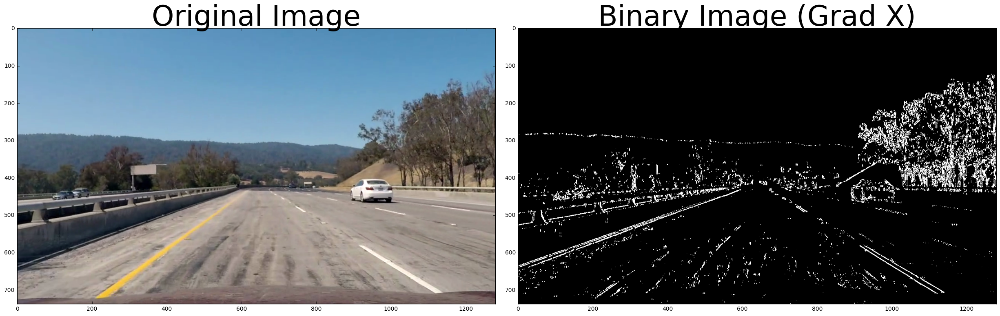

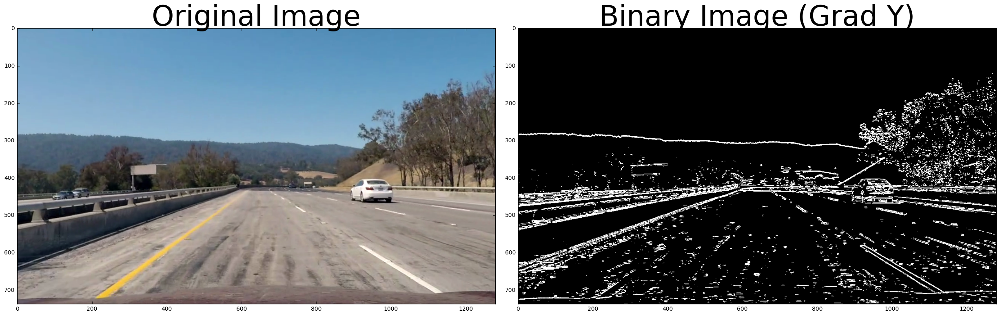

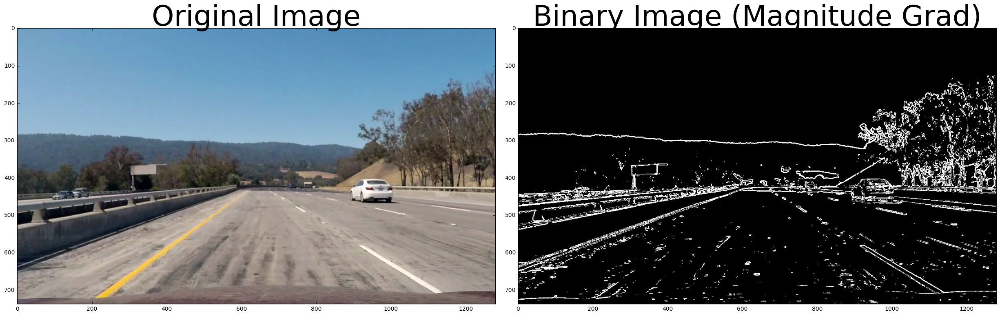

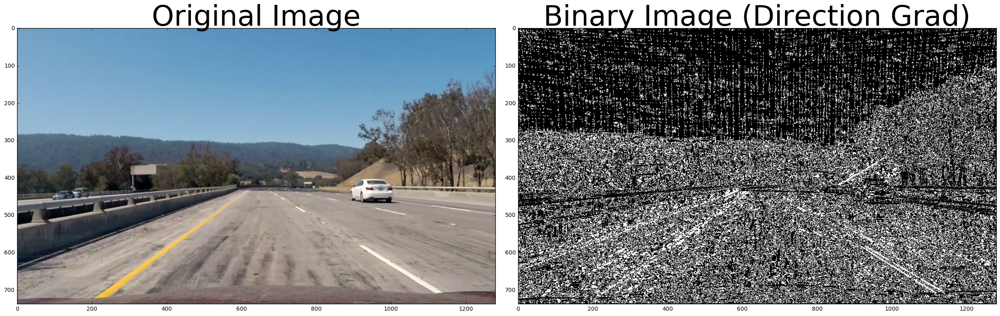

In [10]:
test_image = undistorted_images[2]

# Choose a Sobel kernel size
ksize = 3 # Choose a larger odd number to smooth gradient measurements

# Apply each of the thresholding functions
gradx = abs_sobel_thresh(test_image, orient='x', sobel_kernel=ksize, thresh=(20, 100))
grady = abs_sobel_thresh(test_image, orient='y', sobel_kernel=ksize, thresh=(20, 100))
mag_binary = mag_thresh(test_image, sobel_kernel=ksize, mag_thresh=(30, 100))
dir_binary = dir_threshold(test_image, sobel_kernel=ksize, thresh=(0.7, 1.3))

binary_images = [
    ['Grad X', gradx], 
    ['Grad Y', grady], 
    ['Magnitude Grad', mag_binary], 
    ['Direction Grad', dir_binary]
]

for name, binary_image in binary_images:
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    rgb = cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB)
    ax1.imshow(rgb)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(binary_image, cmap = 'gray')
    ax2.set_title('Binary Image ({})'.format(name), fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

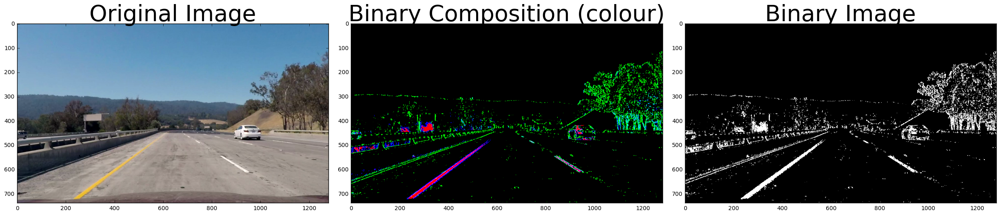

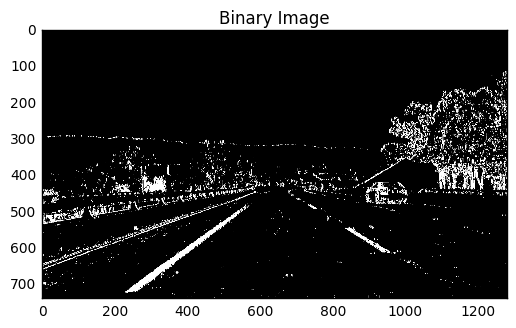

In [11]:
def binary_image(img, s_thresh=(20, 100), l_thresh=(20, 100), return_type='combined'):
    img = np.copy(img)
    # Convert to HSV color space and separate the V channel
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    l_channel = hsv[:,:,1]
    s_channel = hsv[:,:,2]
    
    # Increase the contrast of the saturation channel
    s_channel = s_channel * 2
    
    s_minus_l = s_channel - (255 - l_channel)

    
    # Sobel x lightness
    sobelx_l = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx_l = np.absolute(sobelx_l) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel_l = np.uint8(255*abs_sobelx_l/np.max(abs_sobelx_l))

    # Sobel x saturation
    sobelx_s = cv2.Sobel(s_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx_s = np.absolute(sobelx_s) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel_s = np.uint8(255*abs_sobelx_s/np.max(abs_sobelx_s))
    
    # Threshold x gradient lightness
    l_binary = np.zeros_like(s_channel)
    l_binary[(scaled_sobel_l >= l_thresh[0]) & (scaled_sobel_l <= l_thresh[1])] = 1

    # Threshold x gradient saturation
#     s_binary = np.zeros_like(s_channel)
#     s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    s_binary = np.zeros_like(s_channel)
    s_binary[(scaled_sobel_s >= s_thresh[0]) & (scaled_sobel_s <= s_thresh[1])] = 1
    
    # Threshold color channel
    s_minus_l_binary = np.zeros_like(s_channel)
    s_minus_l_binary[s_minus_l < 200] = 0
    s_minus_l_binary[s_minus_l > 200] = 1
#     s_minus_l_binary = np.zeros_like(scaled_sobel_s_y)
#     s_minus_l_binary[(scaled_sobel_s_y >= s_thresh[0]) & (scaled_sobel_s_y <= s_thresh[1])] = 1
    
    # Stack each channel
    # Note color_binary[:, :, 0] is all 0s, effectively an all black image. It might
    # be beneficial to replace this channel with something else.
    colour_binary = np.dstack((s_minus_l_binary, l_binary, s_binary))
    
    combined_binary = np.zeros_like(s_channel)
    combined_binary = s_minus_l_binary + s_binary + l_binary
    combined_binary[combined_binary < 1] = 0
    combined_binary[combined_binary > 1] = 1
    
    if return_type == 'colour':
        return colour_binary
    return combined_binary

test_image = undistorted_images[4]

colour_result = binary_image(test_image, return_type='colour')
bw_result = binary_image(test_image, return_type='combined')

# Plot the result
f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
f.tight_layout()

rgb = cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB)
ax1.imshow(rgb)
ax1.set_title('Original Image', fontsize=40)

ax2.imshow(colour_result, cmap = 'gray')
ax2.set_title('Binary Composition (colour)', fontsize=40)

ax3.imshow(bw_result, cmap = 'gray')
ax3.set_title('Binary Image', fontsize=40)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

plt.figure()
plt.imshow(bw_result, cmap = 'gray')
plt.title('Binary Image')

## Apply a perspective transform to rectify binary image ("birds-eye view").

In [12]:
def birds_eye_view(img):
    img = np.copy(img)
    height = img.shape[0]
    width = img.shape[1]
    
    src_tl = [555, 450]
    src_tr = [725, 450]
    src_bl = [-200, height]
    src_br = [width + 200, height]
    src = np.float32([src_tl, src_tr, src_br, src_bl])

    dst_tl = [0, 0]
    dst_tr = [width, 0]
    dst_bl = [0, height]
    dst_br = [width, height]
    dst = np.float32([dst_tl, dst_tr, dst_br, dst_bl])

    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(img, M, (width, height))

    return warped, Minv


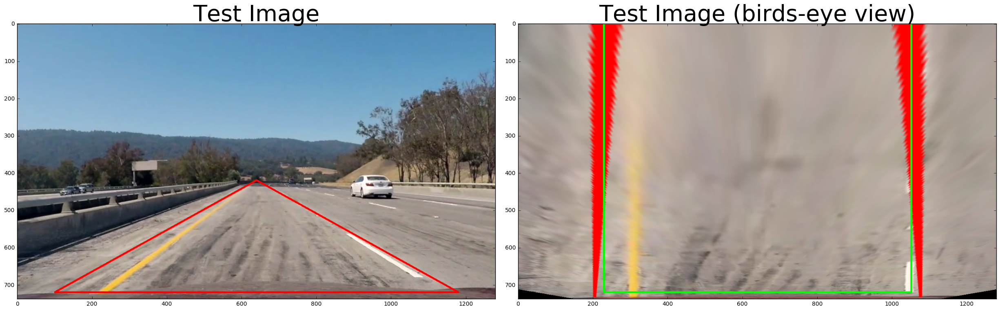

In [13]:
transform_test_image = undistorted_images[0].copy()
polygon_pts = np.int32([
    [640, 420],
    [1180, 720],
    [100, 720]
])
transform_test_image = cv2.polylines(transform_test_image, [polygon_pts], True, color=(0,0,255), thickness = 3)
warped_test_image, Minv = birds_eye_view(transform_test_image)
post_warp_polygon_pts = np.int32([
    [229, 0],
    [1051, 0],
    [1051, 720],
    [229, 720]
])
warped_test_image = cv2.polylines(warped_test_image, [post_warp_polygon_pts], True, color=(0,255,0), thickness = 3)

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()

rgb = cv2.cvtColor(transform_test_image, cv2.COLOR_BGR2RGB)
ax1.imshow(rgb)
ax1.set_title('Test Image', fontsize=40)

rgb_warped = cv2.cvtColor(warped_test_image, cv2.COLOR_BGR2RGB)
ax2.imshow(rgb_warped, cmap = 'gray')
ax2.set_title('Test Image (birds-eye view)', fontsize=40)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

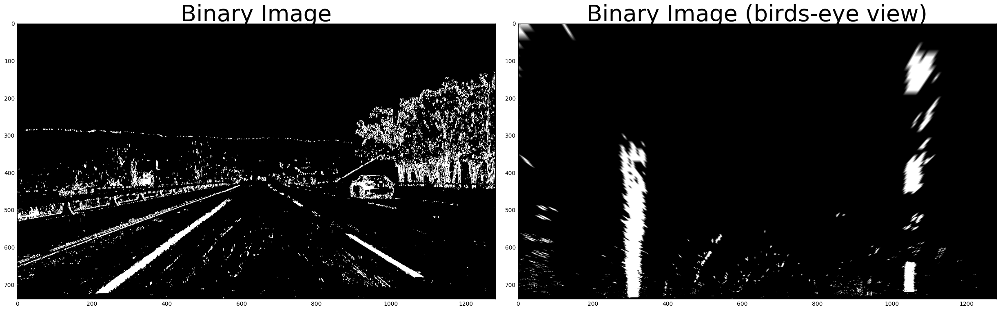

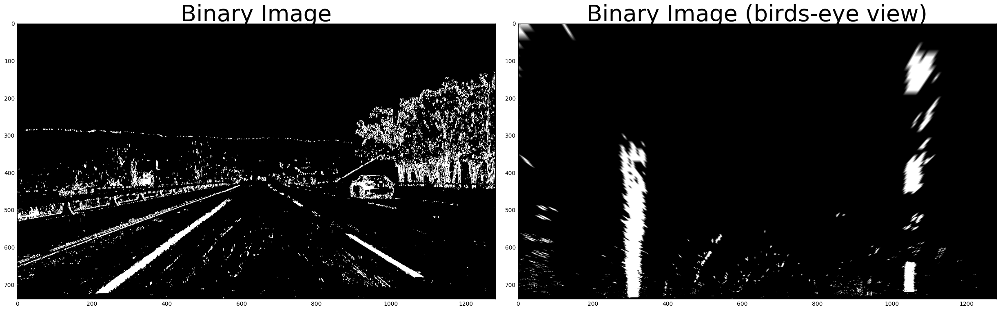

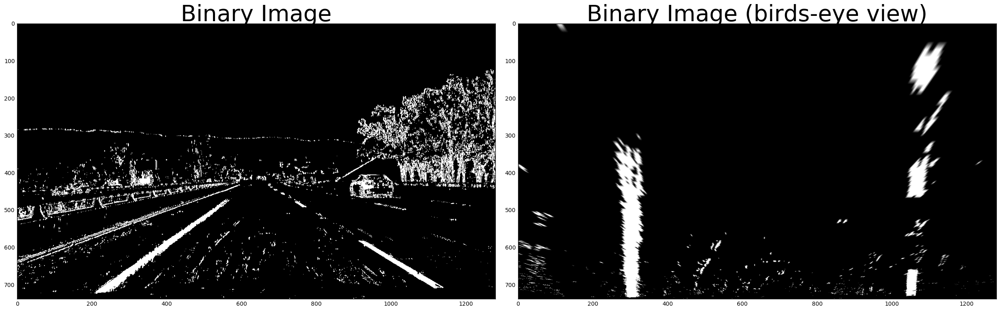

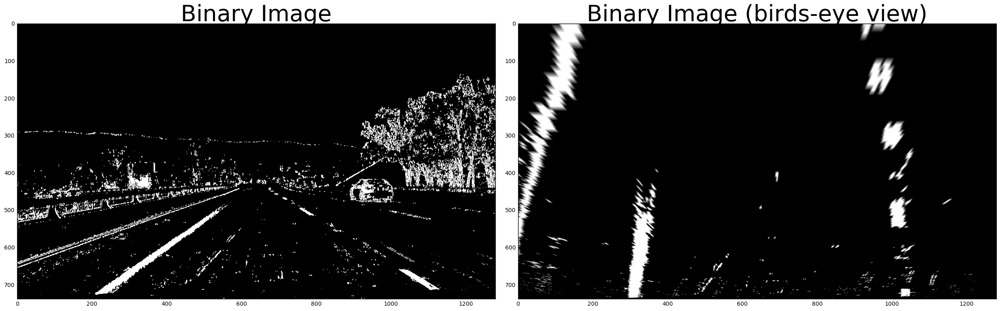

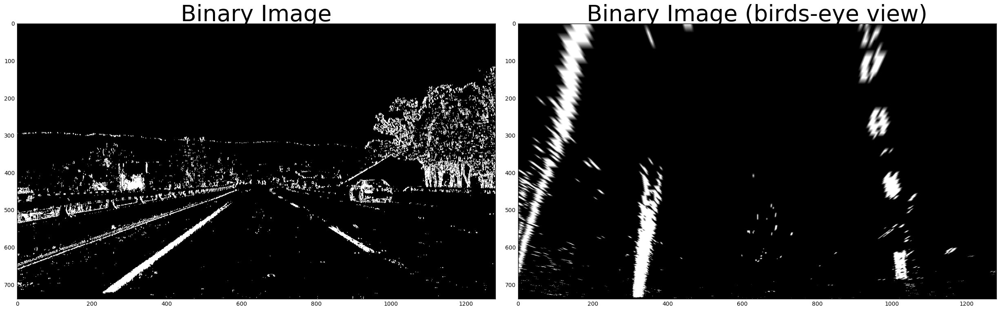

...

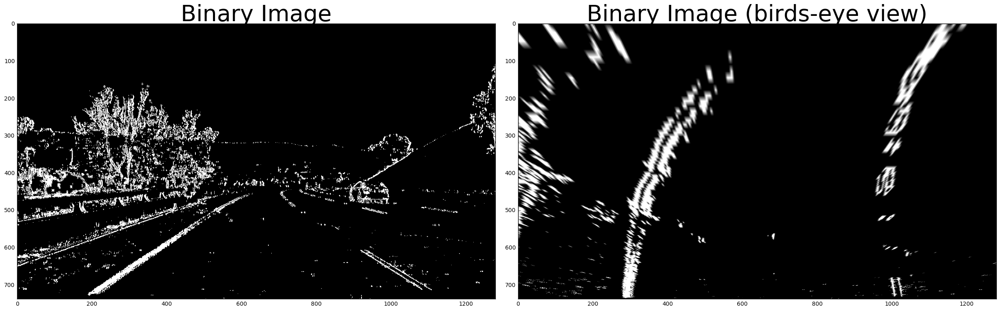

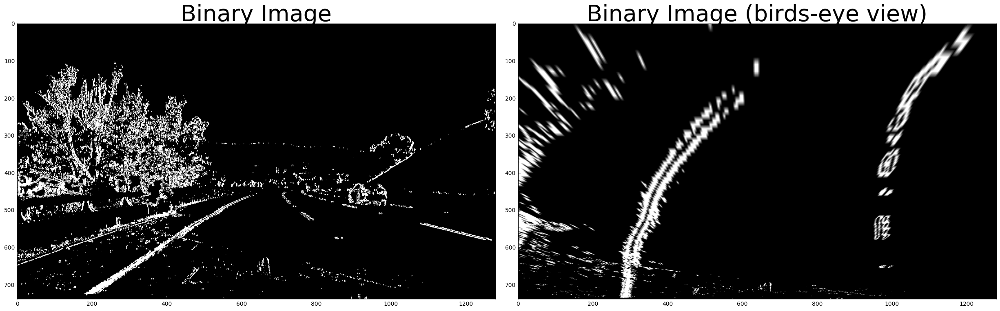

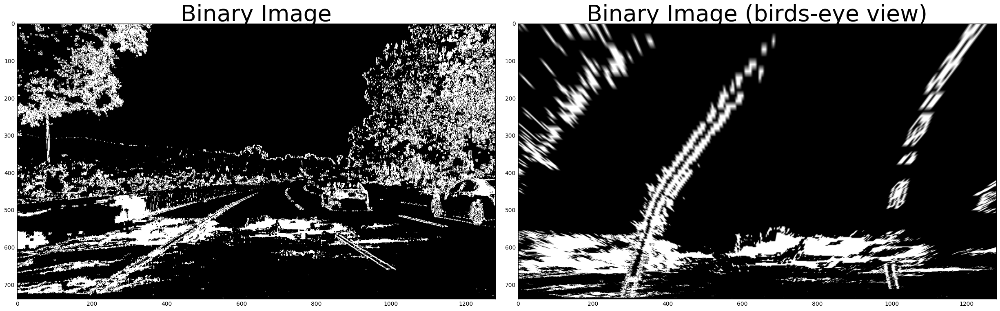

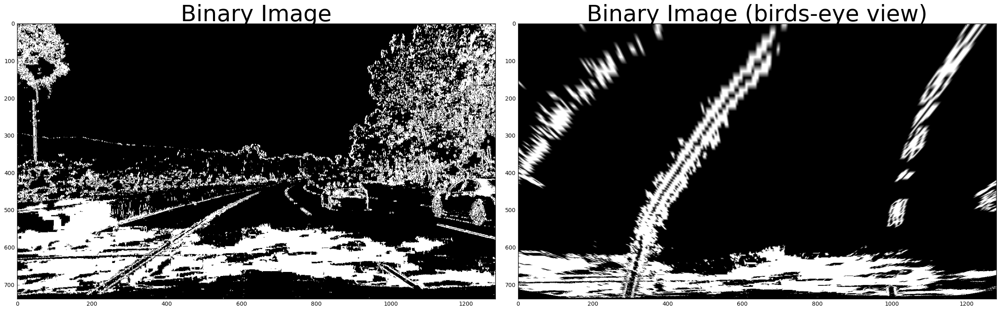

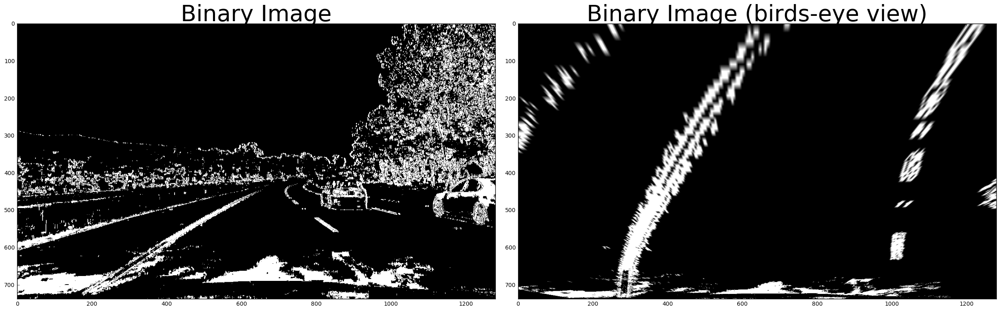

In [14]:
binary_top_down_images = []
for undist in undistorted_images:
    undist = cv2.cvtColor(undist, cv2.COLOR_BGR2RGB)
    bw_result = binary_image(undist, return_type='combined')
    bw_warped, Minv = birds_eye_view(bw_result)
    binary_top_down_images.append(bw_warped)
    
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(bw_result, cmap = 'gray')
    ax1.set_title('Binary Image', fontsize=40)

    ax2.imshow(bw_warped, cmap = 'gray')
    ax2.set_title('Binary Image (birds-eye view)', fontsize=40)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Detect lane pixels and fit to find the lane boundary.

*From the project instructions.*

Another way to approach the sliding window method is to apply a convolution, which will maximize the number of "hot" pixels in each window. A convolution is the summation of the product of two separate signals, in our case the window template and the vertical slice of the pixel image.

You slide your window template across the image from left to right and any overlapping values are summed together, creating the convolved signal. The peak of the convolved signal is where there was the highest overlap of pixels and the most likely position for the lane marker.

Now let's try using convolutions to find the best window center positions in a thresholded road image. The code below allows you to experiment with using convolutions for a sliding window search function. Go ahead and give it a try.

In [15]:
def window_mask(width, height, img_ref, center,level):
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0]-(level+1)*height):int(img_ref.shape[0]-level*height),max(0,int(center-width/2)):min(int(center+width/2),img_ref.shape[1])] = 1
    return output

def find_window_centroids(warped, window_width, window_height, margin):
    
    window_centroids = [] # Store the (left,right) window centroid positions per level
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    
    # First find the two starting positions for the left and right lane by using np.sum to get the vertical image slice
    # and then np.convolve the vertical image slice with the window template 
    
    # Sum quarter bottom of image to get slice, could use a different ratio
    l_sum = np.sum(warped[int(3*warped.shape[0]/4):,:int(warped.shape[1]/2)], axis=0)
    l_center = np.argmax(np.convolve(window,l_sum))-window_width/2
    r_sum = np.sum(warped[int(3*warped.shape[0]/4):,int(warped.shape[1]/2):], axis=0)
    r_center = np.argmax(np.convolve(window,r_sum))-window_width/2+int(warped.shape[1]/2)
    
    # Add what we found for the first layer
    window_centroids.append((l_center,r_center))
    
    # Go through each layer looking for max pixel locations
    for level in range(1,(int)(warped.shape[0]/window_height)):
        # convolve the window into the vertical slice of the image
        image_layer = np.sum(warped[int(warped.shape[0]-(level+1)*window_height):int(warped.shape[0]-level*window_height),:], axis=0)
        conv_signal = np.convolve(window, image_layer)
        # Find the best left centroid by using past left center as a reference
        # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
        offset = window_width/2
        l_min_index = int(max(l_center+offset-margin,0))
        l_max_index = int(min(l_center+offset+margin,warped.shape[1]))
        l_center = np.argmax(conv_signal[l_min_index:l_max_index])+l_min_index-offset
        # Find the best right centroid by using past right center as a reference
        r_min_index = int(max(r_center+offset-margin,0))
        r_max_index = int(min(r_center+offset+margin,warped.shape[1]))
        r_center = np.argmax(conv_signal[r_min_index:r_max_index])+r_min_index-offset
        # Add what we found for that layer
        window_centroids.append((l_center,r_center))

    return window_centroids

In [16]:
# The Line object helps store information about the lane fit and information about the lane to help smooth
# the lane fit for consecutive frames in the video.
class Lane():
    def __init__(self):
        # Define conversions in x and y from pixels space to meters
        self.ym_per_pix = 30.0/720 # meters per pixel in y dimension
        self.xm_per_pix = 3.7/700 # meters per pixel in x dimension
        # was the line detected in the last iteration?
        self.detected = False   
        # The n used to calculate running averages
        self.running_average_n = 24 # One second of video frames.
        # x values of the last n fits of the line
        self.recent_y_fitted_left  = [] 
        self.recent_x_fitted_left  = [] 
        self.recent_y_fitted_right = [] 
        self.recent_x_fitted_right = [] 
        # polynomial coefficients for the last n iterations
        self.left_fits  = []   
        self.right_fits = []
        # polynomial coefficients averaged over the last n iterations
        self.best_fit_left  = None  
        self.best_fit_right = None
        # difference in fit coefficients between last and new fits
#         self.diffs = np.array([0,0,0], dtype='float') 
        # radius of curvature of the line in meters
        self.radius_of_curvature = None 
        # distance in meters of vehicle center from the line
        self.line_base_pos = None 
        # The points for the sliding windows for the left lane line.
        self.sliding_window_points_left = None  
        # The points for the sliding windows for the right lane line.
        self.sliding_window_points_right = None
        # The dictionary of data used to plot the fitted polynomials   
        self.plot = {'y': None, 'left_x': None, 'right_x': None}

Left fit cefs: [ -7.33031761e-04   7.83686338e-01   1.08786926e+02]
Right fit cefs: [ -2.85782363e-06  -5.17519122e-02   1.08490040e+03]
MSE left and right: [  5.33153980e-07   6.97957069e-01   9.52797506e+05]


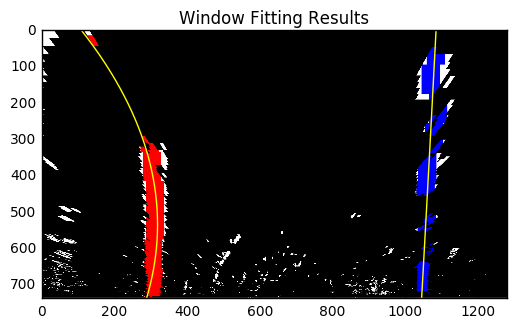

Left fit cefs: [ -7.33031761e-04   7.83686338e-01   1.08786926e+02]
Right fit cefs: [ -2.85782363e-06  -5.17519122e-02   1.08490040e+03]
MSE left and right: [  5.33153980e-07   6.97957069e-01   9.52797506e+05]


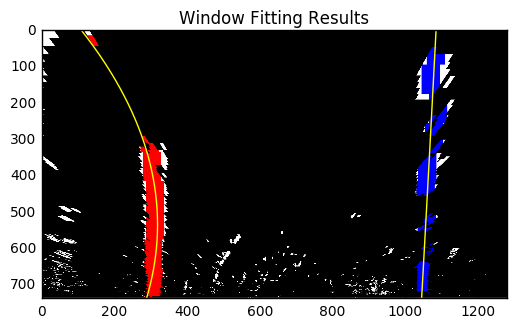

Left fit cefs: [ -7.36365889e-04   8.10689248e-01   8.85458288e+01]
Right fit cefs: [  9.20854281e-06  -8.22612371e-02   1.11028798e+03]
MSE left and right: [  5.55881233e-07   7.97360569e-01   1.04395702e+06]


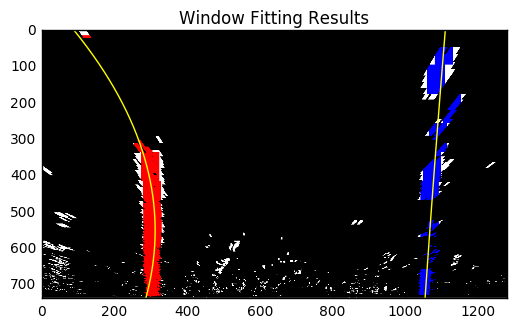

Left fit cefs: [ -9.07517771e-04   9.41143489e-01   9.93055349e+01]
Right fit cefs: [ -2.20369956e-04   3.09177946e-01   9.22153830e+02]
MSE left and right: [  4.72172120e-07   3.99380448e-01   6.77079316e+05]


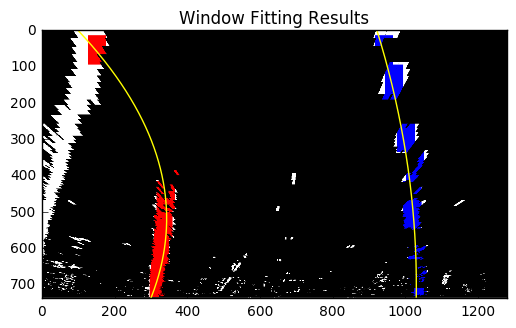

Left fit cefs: [ -9.02754732e-04   9.53596808e-01   1.01386548e+02]
Right fit cefs: [ -2.38151969e-06   1.53444430e-01   9.29016990e+02]
MSE left and right: [  8.10671921e-07   6.40243827e-01   6.84972149e+05]


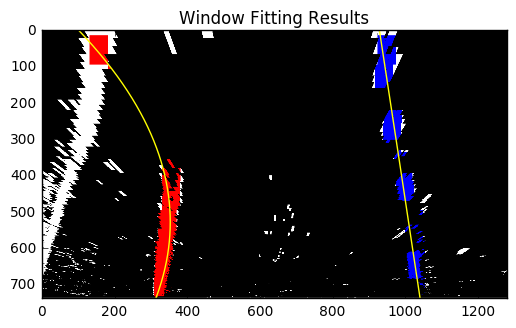

Left fit cefs: [  5.07739999e-04  -5.13796625e-01   4.64834444e+02]
Right fit cefs: [  2.41486097e-04  -4.42558932e-02   9.40694476e+02]
MSE left and right: [  7.08911402e-08   2.20468499e-01   2.26442770e+05]


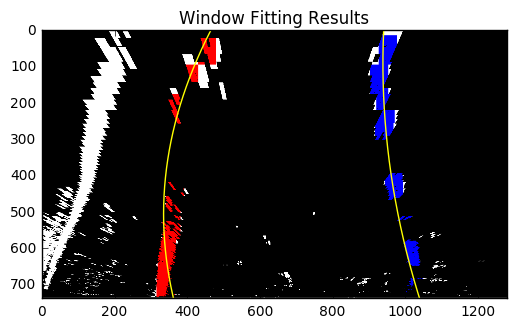

Left fit cefs: [ -8.49726226e-04   9.63354621e-01   7.52996973e+01]
Right fit cefs: [  2.58315503e-04  -1.47908772e-01   9.89475891e+02]
MSE left and right: [  1.22775647e-06   1.23490633e+00   8.35718113e+05]


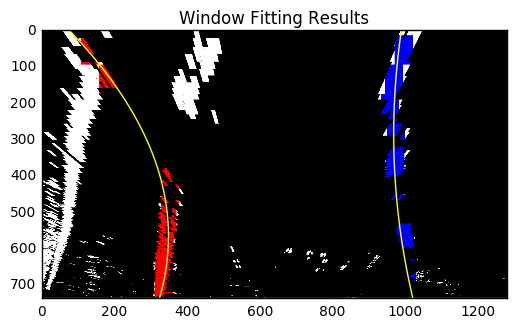

Left fit cefs: [  7.21918003e-04  -7.45665763e-01   4.90813090e+02]
Right fit cefs: [  3.75962576e-04  -3.44757212e-01   1.08160506e+03]
MSE left and right: [  1.19685158e-07   1.60727667e-01   3.49035148e+05]


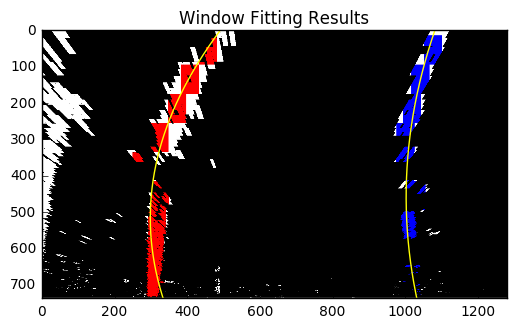

Left fit cefs: [  4.82495890e-04  -7.45972376e-01   5.84502110e+02]
Right fit cefs: [  7.15408516e-04  -6.57417606e-01   1.13615271e+03]
MSE left and right: [  5.42482913e-08   7.84194722e-03   3.04318381e+05]


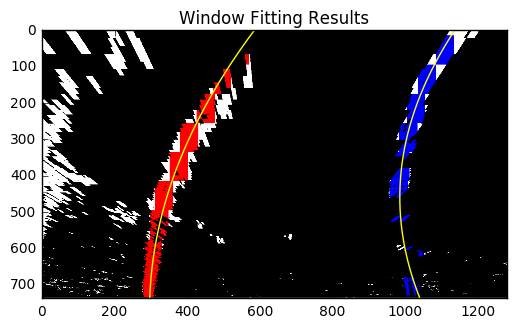

Left fit cefs: [ -3.20711319e-05  -3.78667731e-01   5.62291764e+02]
Right fit cefs: [  6.09669041e-04  -6.94456957e-01   1.16710487e+03]
MSE left and right: [  4.11830450e-07   9.97228349e-02   3.65798889e+05]


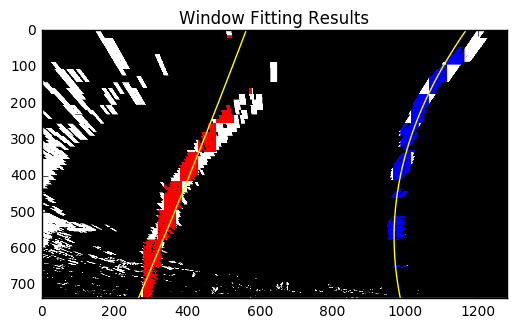

Left fit cefs: [  2.51012176e-04  -7.09062520e-01   6.73223259e+02]
Right fit cefs: [ -4.67889236e-04   7.13956657e-01   5.79093501e+02]
MSE left and right: [  5.16819239e-07   2.02498358e+00   8.86041144e+03]


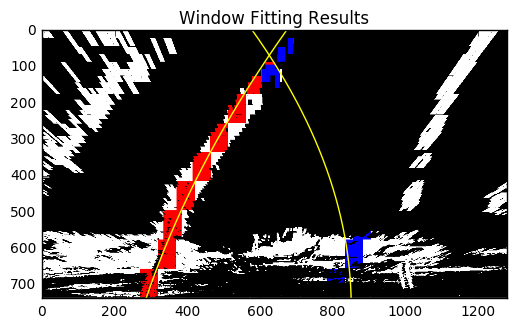

Left fit cefs: [  4.73128579e-04  -8.60093706e-01   6.91100257e+02]
Right fit cefs: [ -2.25450531e-05  -4.42238630e-01   1.20385406e+03]
MSE left and right: [  2.45692350e-07   1.74602864e-01   2.62916463e+05]


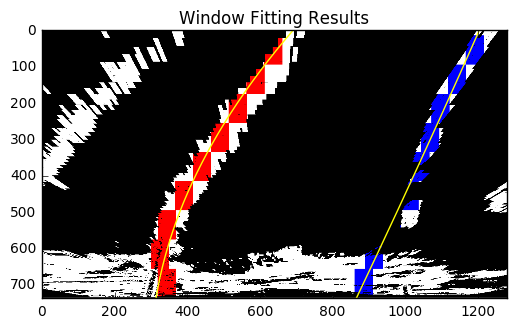

Left fit cefs: [  3.71834608e-04  -7.80736094e-01   6.57064785e+02]
Right fit cefs: [  4.43280199e-04  -5.90644122e-01   1.21003718e+03]
MSE left and right: [  5.10447244e-09   3.61349576e-02   3.05778468e+05]


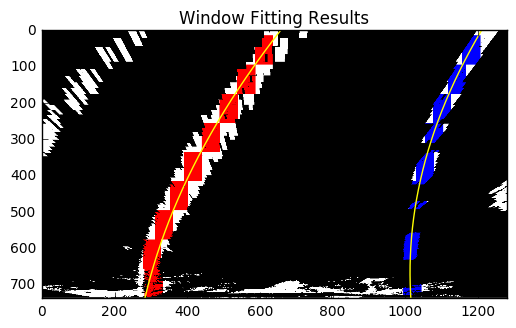

In [17]:
def find_lane_lines(warped, lane = Lane()):
    # window settings
    window_width = 50
    window_height = 80 # Break image into 9 horizontal layers since image height is 720
    margin = 50 # How much to slide left and right for searching

    window_centroids = find_window_centroids(warped, window_width, window_height, margin)

    # If we found any window centers
    if len(window_centroids) > 0:
        lane.detected = True
        
        # Points used to draw all the left and right windows
        l_points = np.zeros_like(warped)
        r_points = np.zeros_like(warped)

        # Go through each level and draw the windows 	
        for level in range(0,len(window_centroids)):
            # Window_mask is a function to draw window areas
            l_mask = window_mask(window_width,window_height,warped,window_centroids[level][0],level)
            r_mask = window_mask(window_width,window_height,warped,window_centroids[level][1],level)
            # Add graphic points from window mask here to total pixels found 
            l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
            r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255

        lane.sliding_window_points_left  = l_points
        lane.sliding_window_points_right = r_points
        
        left_y  = np.nonzero(l_points)[0]
        left_x  = np.nonzero(l_points)[1]
        right_y = np.nonzero(r_points)[0]
        right_x = np.nonzero(r_points)[1]
        
        if len(lane.recent_y_fitted_left) == 0:
            lane.recent_y_fitted_left  = [left_y]
            lane.recent_x_fitted_left  = [left_x]
            lane.recent_y_fitted_right = [right_y]
            lane.recent_x_fitted_right = [right_x]
        else:
            lane.recent_y_fitted_left.append(left_y)
            lane.recent_x_fitted_left.append(left_x)
            lane.recent_y_fitted_right.append(right_y)
            lane.recent_x_fitted_right.append(right_x)
            
            if len(lane.recent_y_fitted_left) > lane.running_average_n:
                del lane.recent_y_fitted_left[0]
                del lane.recent_x_fitted_left[0]
                del lane.recent_y_fitted_right[0]
                del lane.recent_x_fitted_right[0]

        all_left_y  = [val for sublist in lane.recent_y_fitted_left for val in sublist]
        all_left_x  = [val for sublist in lane.recent_x_fitted_left for val in sublist]
        all_right_y = [val for sublist in lane.recent_y_fitted_right for val in sublist]
        all_right_x = [val for sublist in lane.recent_x_fitted_right for val in sublist]
        
        # Fit a second order polynomial to each
        left_fit = np.polyfit(all_left_y, all_left_x, 2)
        right_fit = np.polyfit(all_right_y, all_right_x, 2)
        
        if len(lane.left_fits) == 0:
            lane.left_fits  = [left_fit]
            lane.right_fits = [right_fit]
        else:
            lane.left_fits.append(left_fit)
            lane.right_fits.append(right_fit)
            
            if len(lane.left_fits) > lane.running_average_n:
                del lane.left_fits[0]
                del lane.right_fits[0]
        
        lane.best_fit_left  = np.mean(lane.left_fits, axis=0)
        lane.best_fit_right = np.mean(lane.right_fits, axis=0)
        
        print('Left fit cefs: {}'.format(left_fit))
        print('Right fit cefs: {}'.format(right_fit))
        print('MSE left and right: {}'.format(((left_fit - right_fit) ** 2)))
        
        # Generate x and y values for plotting
        lane.plot['y']       = np.linspace(0, warped.shape[0]-1, warped.shape[0] )
        lane.plot['left_x']  = lane.best_fit_left[0]*lane.plot['y']**2 + lane.best_fit_left[1]*lane.plot['y'] + lane.best_fit_left[2]
        lane.plot['right_x'] = lane.best_fit_right[0]*lane.plot['y']**2 + lane.best_fit_right[1]*lane.plot['y'] + lane.best_fit_right[2]
        
    else:
        lane.detected = False
    
    return lane

for warped in binary_top_down_images:
    lane = find_lane_lines(warped, Lane())
        
    # Draw the results
    warped[warped > 0] = 255
    output = np.array(cv2.merge((warped, warped, warped)),np.uint8)
    # Color in left and right line pixels
    output[np.logical_and((lane.sliding_window_points_left > 0), (warped > 0))] = [255, 0, 0]
    output[np.logical_and((lane.sliding_window_points_right > 0), (warped > 0))] = [0, 0, 255]


    # Display the final results
    plt.figure()
    plt.imshow(output)
    plt.plot(lane.plot['left_x'], lane.plot['y'], color='yellow')
    plt.plot(lane.plot['right_x'], lane.plot['y'], color='yellow')
    plt.title('Window Fitting Results')
    plt.xlim(0, output.shape[1])
    plt.ylim(output.shape[0], 0)
    plt.show()

## Determine the curvature of the lane and vehicle position with respect to center.

In [78]:
# Define y-value where we want radius of curvature
# I'll choose the maximum y-value, corresponding to the bottom of the image
y_eval = np.max(lane.plot['y'])
left_curverad = ((1 + (2*lane.best_fit_left[0]*y_eval + lane.best_fit_left[1])**2)**1.5) / np.absolute(2*lane.best_fit_left[0])
right_curverad = ((1 + (2*lane.best_fit_right[0]*y_eval + lane.best_fit_right[1])**2)**1.5) / np.absolute(2*lane.best_fit_right[0])
print(left_curverad, right_curverad)

1127.40549799 1451.69880987


In [89]:
def lane_curvature_description(lane):
    lefty  = np.nonzero(lane.sliding_window_points_left)[0]
    leftx  = np.nonzero(lane.sliding_window_points_left)[1]
    righty = np.nonzero(lane.sliding_window_points_right)[0]
    rightx = np.nonzero(lane.sliding_window_points_right)[1]
    
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(lefty*lane.ym_per_pix, leftx*lane.xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*lane.ym_per_pix, rightx*lane.xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*lane.ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*lane.ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    # Now our radius of curvature is in meters
    curvature = np.mean([left_curverad, right_curverad])
    previous_curvature = lane.radius_of_curvature
    # If the Lane object has a previous curvature value, take the weighted average of that curvature 
    # and the newly found one to help smooth the transition in curvature from frame to frame in the video.   
    if previous_curvature:
        curvature = (curvature + previous_curvature * 4) / 5
    
    curvature = int(curvature)
    lane.radius_of_curvature = curvature
    description = 'Radius of Curvature = {}(m)'.format(curvature)
    if curvature > 10000:
        description = 'Straight Road: Curvature > 10000(m)'
    return description

lane_curvature = lane_curvature_description(lane)
print(lane_curvature)

Radius of Curvature = 421(m)


In [90]:
def lane_position_description(lane):
    width = lane.sliding_window_points_left.shape[1]
    
    left_x_from_fit  = lane.plot['left_x'][-1]
    right_x_from_fit = lane.plot['right_x'][-1]
    center_x = width / 2.0
    lane_center = right_x_from_fit - left_x_from_fit

    position_relative_to_center_pix = center_x - lane_center
    position_relative_to_center_m = lane.xm_per_pix * position_relative_to_center_pix
    
    direction = 'left' if position_relative_to_center_m < 0 else 'right'
    distance = np.abs(position_relative_to_center_m)
    
    previous_distance = lane.line_base_pos
    # If the Lane object has a previous distance value, take the weighted average of that distance 
    # and the newly found one to help smooth the transition in distance from frame to frame in the video.   
    if previous_distance:
        distance = (distance + previous_distance * 4) / 5
    
    lane.line_base_pos = distance
    formatted_distance = "%.2f" % distance
    description = 'Vehicle is {}m {} of center'.format(formatted_distance, direction)
    return description
    
car_position = lane_position_description(lane)
print(car_position)

Vehicle is 0.21m left of center


## Warp the detected lane boundaries back onto the original image.

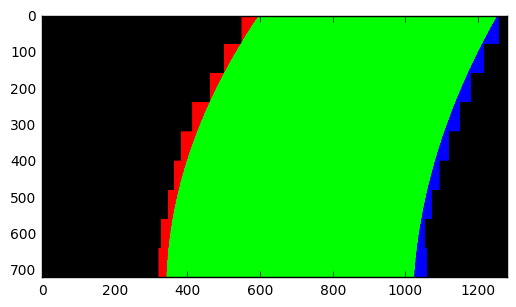

In [91]:
# Create an image with just the l_points in red, r_points in blue and polynomials in yellow
def produce_lane_annotation_image(lane):
    
    red   = [255, 0, 0]
    green = [0, 255, 0]
    blue  = [0, 0, 255]

    zeros_channel = np.zeros_like(lane.sliding_window_points_left) 
    lane_annotation = np.array(cv2.merge((zeros_channel, zeros_channel, zeros_channel)),np.uint8)
    lane_annotation[lane.sliding_window_points_left > 0] = red
    lane_annotation[lane.sliding_window_points_right > 0] = blue

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([lane.plot['left_x'], lane.plot['y']]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([lane.plot['right_x'], lane.plot['y']])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    lane_annotation = cv2.fillPoly(lane_annotation, np.int_([pts]), green)
    
    return lane_annotation

lane_annotation = produce_lane_annotation_image(lane)
plt.imshow(lane_annotation)
plt.show()

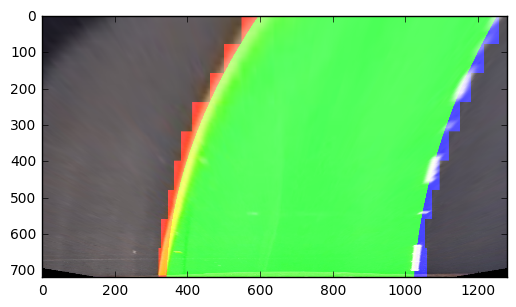

In [92]:
# Lay that image on top of the warped version of the colour image to check everything is ok.
lane_lines_test_image = undistorted_images[4].copy()
warped_image, Minv = birds_eye_view(lane_lines_test_image)
warped_image = cv2.cvtColor(warped_image, cv2.COLOR_BGR2RGB)
warped_image_annotated = cv2.addWeighted(warped_image, 1, lane_annotation, 1, 0.0)

plt.imshow(warped_image_annotated)
plt.show()

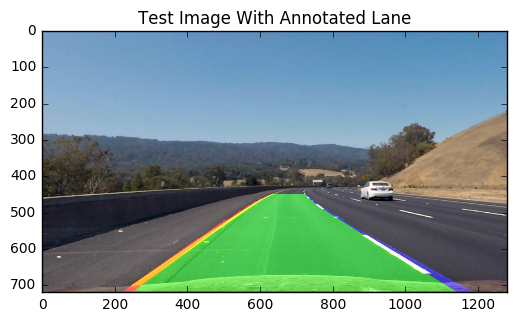

In [93]:
# Unwarp the warped annotation and apply it to the original undistorted colour image
lane_lines_test_image = undistorted_images[4].copy()
# Warp the blank back to original image space using inverse perspective matrix (Minv)
unwarp = cv2.warpPerspective(lane_annotation, Minv, (lane_annotation.shape[1], lane_annotation.shape[0])) 
# Combine the result with the original image
lane_lines_test_image = cv2.cvtColor(lane_lines_test_image, cv2.COLOR_BGR2RGB)
annotated_image = cv2.addWeighted(lane_lines_test_image, 1, unwarp, 0.5, 0)
plt.imshow(annotated_image)
plt.title('Test Image With Annotated Lane')
plt.show()

## Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

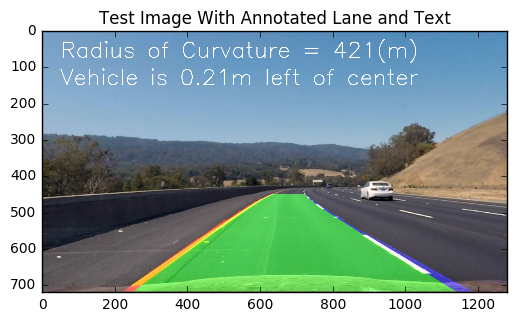

In [94]:
def add_text_to_image(image, lines_of_text):
    line_height = 75
    for i in range(len(lines_of_text)):
        x = 50
        y = line_height * (i+1)
        text = lines_of_text[i]
        image = cv2.putText(image, text, (x, y), cv2.FONT_HERSHEY_SIMPLEX, 2, (255,255,255), 2)
    
    return image

annotated_image = add_text_to_image(annotated_image, [lane_curvature, car_position])

plt.imshow(annotated_image)
plt.title('Test Image With Annotated Lane and Text')
plt.show()

## Turn this process into a pipeline

In [66]:
def annotate_image_with_lane_info(binary_warped_image, image_to_annotate, lane = Lane()):
    warped_image_width = binary_warped_image.shape[1]
    
    lane_curvature   = lane_curvature_description(lane)
    position_in_lane = lane_position_description(lane)
    
    return add_text_to_image(image_to_annotate, [lane_curvature, position_in_lane])

In [67]:
def find_and_highlight_lane(rgb_image, lane = Lane()):
    # The camera claibration matrix  and 'dist' were found through a process of 'chessboard' image analysis.     
    mtx = np.array([[1.15396093e+03, 0.00000000e+00, 6.69705357e+02],
                    [0.00000000e+00, 1.14802496e+03, 3.85656234e+02],
                    [0.00000000e+00, 0.00000000e+00, 1.00000000e+00]])
    dist = np.array([-2.41017956e-01, -5.30721173e-02, -1.15810355e-03, -1.28318856e-04, 2.67125290e-02])
    
    undistorted_img      = cv2.undistort(rgb_image, mtx, dist, None, mtx)
    binary_img           = binary_image(undistorted_img, return_type='combined')
    binary_warped, M_inv = birds_eye_view(binary_img)
    
    lane = find_lane_lines(binary_warped, lane)
    
    lane_annotation     = produce_lane_annotation_image(lane)
    unwarp_dimensions   = (lane_annotation.shape[1], lane_annotation.shape[0])
    unwarped_annotation = cv2.warpPerspective(lane_annotation, M_inv, unwarp_dimensions)
    
    annotated_image = cv2.addWeighted(undistorted_img, 1, unwarped_annotation, 0.5, 0)
    annotated_image = annotate_image_with_lane_info(binary_warped, annotated_image, lane)
    
    return annotated_image, lane

## Apply the pipeline to the test images

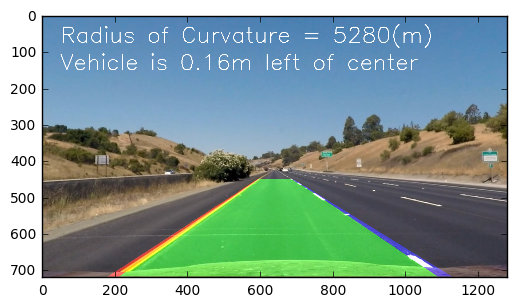

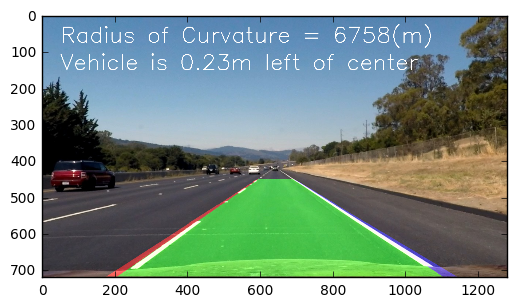

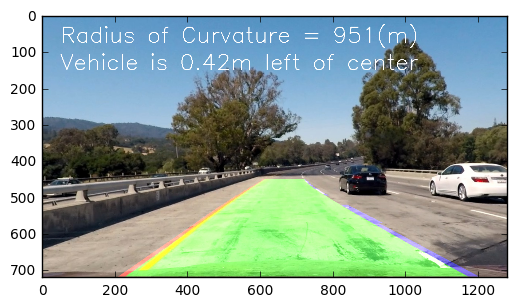

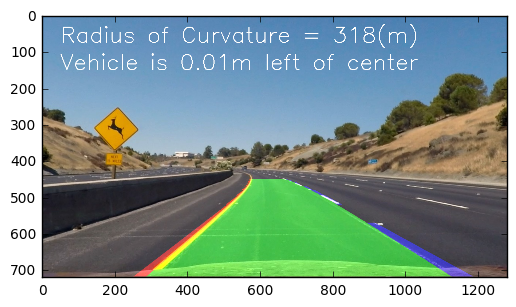

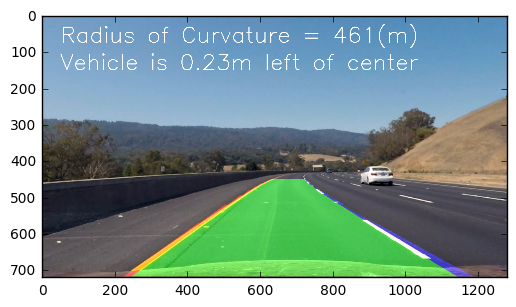

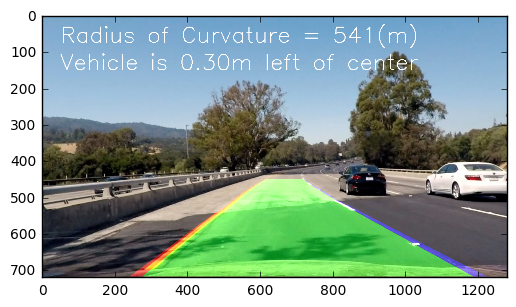

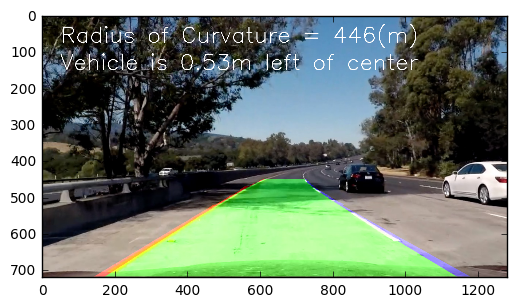

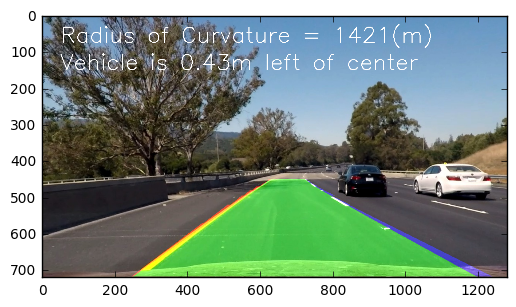

In [81]:
test_images = glob.glob('./test_images/*.jpg')

for fname in test_images:
    image = cv2.imread(fname)
    rgb_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)    
    annotated_image, test_image_lane = find_and_highlight_lane(rgb_image, Lane())
    
    plt.imshow(annotated_image)
    plt.show()

## Apply the pipeline to the test video

In [108]:
project_video_output = './project_video_annotated.avi'
cap = cv2.VideoCapture('./project_video.mp4')

# Define the codec and create VideoWriter object
fourcc = cv2.VideoWriter_fourcc(*'SVQ3')
out = cv2.VideoWriter(project_video_output, fourcc, 24.0, (1280, 720))

video_lane = Lane()

while(cap.isOpened()):
    ret, frame = cap.read()
    
    if ret==True:   
        annotated_image, video_lane = find_and_highlight_lane(frame, video_lane)

        # write the annotated frame
        out.write(annotated_image)
    else:
        break

# Release everything if the job is finished
cap.release()
out.release()

KeyboardInterrupt: 